##  Exploration 3. 인물사진을 만들어 보자 

# Project '인물 모드 문제점 찾기'

**[프로젝트 목표]**
1. **shallow focus 이미지 생성**해보고 
2. 해당 이미지에서 **문제점**을 찾고 (제대로 segmentation이 안된 부분을 표시한다거나 등)
3. 해결 방안을 제안
    - DeepLab 모델의 Semantic Segmentation이 만들어낸 Mask 영역에 어떻게 적용해서 문제를 보완하게 되는지 설명
    - **메커니즘이 포함된 솔루션 제안**
    
    
**[진행과정]**
1. 인물모드 구현
    - 최소 3장 이상의 인물모드(배경이 흐릿한) 사진 생성
        - 사람, 동물 사진 각 1장씩 생성
    - semantic segmentation으로 활용 가능한 다양한 기법 활용
        - 크로마키 배경합성(배경을 다른 이미지로 교체)
2. 이미지에서 문제점 찾기
    - 제대로 segmentation이 안된 부분을 표시해서 첨부
3. 솔루션 제안
    - 매커니즘 설명 첨부

---

In [1]:
# 주요 라이브러리 버전 확인
# importlib: 사용자가 파이썬의 import 시스템과 상호작용하기 위한 API를 제공하는 내장 라이브러리
# 사용자는 import 함수의 구현 내용과, 실행에 필요한 하위 함수들을 이용해 필요에 맞는 임포터를 직접 구현하거나 임포트 관련 기능들을 자유롭게 사용할 수 있음
# importlib.metadata: 설치된 패키지 메타 데이터에 대한 접근을 제공하는 라이브러리.
# 해당 코드 블럭에서는 importlib.metadata 안에 있는 version() 함수를 이용하여 pixellib 라이브러리의 버전을 확인

from importlib.metadata import version
import cv2
import pixellib

print("cv2 version:", cv2.__version__)
print("pixellib version:", version('pixellib'))

cv2 version: 4.5.3
pixellib version: 0.7.1


---

# Step 1. 인물모드 구현

**`아웃포커싱 = Shallow depth of field = Shallow focus`**
- 배경을 흐리게 하는 기술
- bokeh 보케
- portrait 인물사진 : 인물에 포커스를 둔 사진

- 핸드폰의 `인물사진 모드 portrait mode` 구현
    - 듀얼 카메라, 화각이 다른 두 렌즈를 사용해서 아웃포커싱 기능을 흉내
        - 일반(광각)렌즈 : 배경촬영
        - 망원렌즈 : 인물을 촬영한 뒷배경을 흐리게 촬영
        - 두 사진을 적절히 합성
- 딥러닝을 적용해서 2개의 렌즈 효과를 구현해본다
    - `Image Segmentation`
    

<img src='./img/shallow_focus.png' width=70% height=70%>


**Image Segmentation**
- 이미지에서 배경과 사람을 분리
    - 분리된 배경을 blur 처리
    - 사람 이미지와 배경 합성
  
  
**[과정]**
1. 피사체와 배경이 있는 사진 준비
    - 배경과 피사체의 거리가 약간 멀리 떨어진
2. Semantic Segmentation으로 피사체(사람)와 배경 분리
3. `Blurring` 기술로 배경을 흐리게 변환
4. 피사체를 배경의 원래 위치에 합성

In [4]:
# necessary library
'''
os: Operating System의 줄임말로, 운영체제에서 제공되는 여러 기능을 파이썬에서 사용할 수 있도록 함 
    (Ex. 디렉토리 경로 이동, 시스템 환경 변수 가져오기 등)
urllib: URL 작업을 위한 여러 모듈을 모은 패키지 - web에서 데이터를 다운로드할때 필요
    (Ex. urllib.request, urllib.parse, ...)
cv2: OpenCV 라이브러리로, 실시간 컴퓨터 비전을 목적으로 한 프로그래밍 라이브러리
numpy(NumPy): 행렬이나 대규모 다차원 배열을 쉽게 처리할 수 있도록 지원하는 라이브러리. 
    데이터 구조 외에도 수치 계산을 위해 효율적으로 구현된 기능을 제공
pixellib: 이미지 및 비디오 segmentation을 수행하기 위한 라이브러리. 
pixellib.semantic: segmentation 기법 중, semantic segmentation을 쉽게 사용할 수 있도록 만든 라이브러리
matplotlib: 파이썬 프로그래밍 언어 및 수학적 확장 NumPy 라이브러리를 활용한 플로팅 라이브러리로, 데이터 시각화 도구
'''

import os
import urllib
import cv2
import numpy as np
from pixellib.semantic import semantic_segmentation
from matplotlib import pyplot as plt

In [3]:
# 실습폴더 생성, 데이터 폴더 연결
# $ mkdir -p ~/aiffel/workplace/EXPLORATION/Ex03/project_segmentation/models
# $ mkdir -p ~/aiffel/workplace/EXPLORATION/Ex03/project_segmentation/images
# $ ln -s ~/data/* ~/aiffel/workplace/EXPLORATION/Ex03/project_segmentation/images

# 1. 이미지 불러오기
- 준비한 이미지 파일의 경로를 이용하여, 이미지 파일을 읽음
- `cv2.imread(경로)`: 경로에 해당하는 이미지 파일을 읽어서 변수에 저장
    - imread() 함수는 1개의 이미지를 return하기때문에 각 이미지를 개별적으로 읽는 반복문이 필요
- `glob.glob()` : is used to get a list of file paths matching the specified pattern

In [10]:
# load image data

import glob

img_path = './project_segmentation/images/*.jpg'
img_origs = [cv2.imread(img) for img in glob.glob(img_path)] 

for img_orig in img_origs:
    print(img_orig.shape)

(2304, 3456, 3)
(4032, 3024, 3)


- 가로형 인물 사진 1개, 세로형 고양이 사진 1개를 사용할 예정

## 이미지 미리보기
- OpenCV는 이미지를 **BGR** 형식으로 return함
- matplotlib의 [plt.imshow()](https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.imshow.html)`는 저장된 데이터를 이미지 형식으로 표시할때 RGB 형식으로 출력함
   - `cv2.cvtColor(입력 이미지, 색상 변환 코드)`: 입력 이미지의 색상 채널을 변경
     - `cv2.COLOR_BGR2RGB` : 이미지 색상 채널을 BGR -> RGB 형식으로 변경
     
- [plt.show()](https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.show.html): 현재 열려있는 모든 figure를 표시 (여기서 figure는 이미지, 그래프 등) 

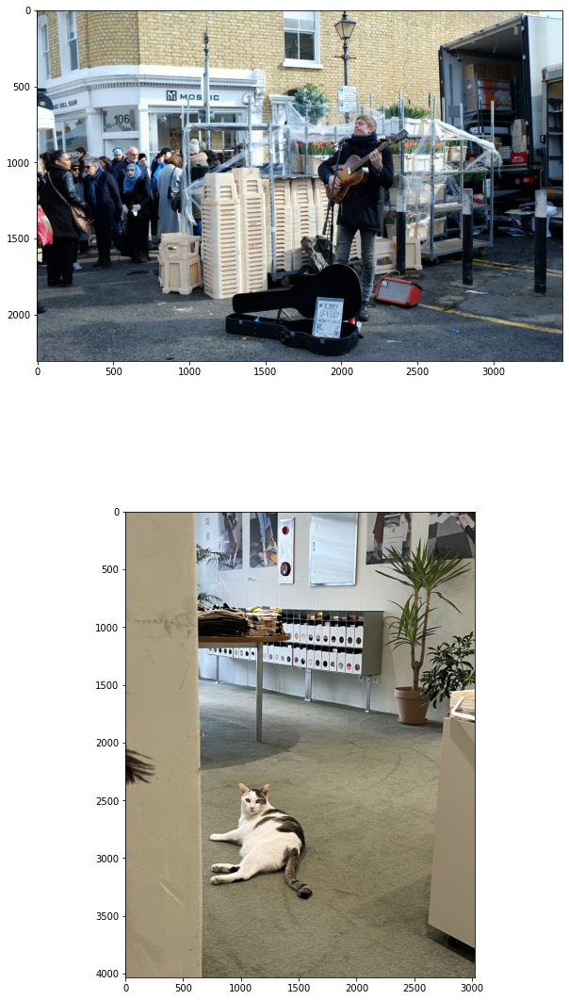

In [17]:
# Set the number of columns based on the number of images
num_cols = len(img_origs)

# Set the figure size
# plt.figure(figsize=(num_cols * 10, 10)) # in the same row
plt.figure(figsize=(10, num_cols * 10)) # in a new row

# Plot each image 
for i, img_orig in enumerate(img_origs, 1):
#     plt.subplot(1, num_cols, i) # in the same row
    plt.subplot(num_cols, 1, i) # in a new row
    # 이미지 형식 변환 BGR -> RGB
    plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
#     plt.axis('off')  # Turn off axis labels to make it cleaner

plt.show()

---
# 2. Segmentation으로 사람 분리하기
- 사람과 피사체를 분리
- 포토샵 `누끼 따기`와 동일한 작업


---

## 💡 Segmentation?
- 이미지에서 픽셀단위로 관심 object를 추출하는 방법 : image segmentation
- 모든 픽셀에 label 할당
    - 같은 label = '공통적인 특징'을 가진다
    
    
**Semantic segmentation**
- 물리적 의미 단위로 인식하고 분류
- 추상적인 정보를 이미지에서 추출
    - 이미지에서 픽셀을 사람, 자동차, 비행기 등의 물리적 단위로 분류(classification)
  
  
**Instance segementation**
- object 개별에 다른 label 할당
- instance ID + class label => semantic seg 학습 가능


**Watershed segmentation**
- 딥러닝 기반 방법 이전의 방식
- 이미지를 grayscale로 변환해서 물체의 '경계'를 나눔
- 참고 : [opencv-python tutorial](https://opencv-python.readthedocs.io/en/latest/doc/27.imageWaterShed/imageWaterShed.html)


---
## 💡 Semantic segmentation

- 주로 FCN, SegNet, U-Net 모델 사용
- 그 중에서 `DeepLab` 모델 사용

## 💡 DeepLab 알고리즘
**[DeepLab v3+](https://bloglunit.wordpress.com/2018/07/02/deeplab-v3-encoder-decoder-with-atrous-separable-convolution-for-semantic-image-segmentation/)**
- separable convolution과 atrous convolution을 결합
- atrous separable convolution의 활용을 제안


### Atrous convolution
<a href='http://www.mdpi.com/2072-4292/9/5/498/htm'><img src='https://bloglunit.files.wordpress.com/2018/07/atrous.png' width=60% height=60%></a>
- 필터 내부에 빈 공간을 둠
- 빈 공간을 둘지 결정하는 파라미터 : `rate`
    - `r=1` : 기존 convolution과 동일
    - r이 커질수록 빈 공간이 넓어짐


**[이점]**
- 파라미터수를 늘리지 않으면서 receptive field를 크게 키울수 있음
    - field of view : 한 픽셀이 볼 수 있는 영역
    - semantic segmentation에서 높은 성능을 내기 위해서는 convolutional neural network의 **마지막에 존재하는 한 픽셀이 입력값에서 어느 크기의 영역을 커버할 수 있는지를 결정하는 receptive field 크기가 중요**하게 작용
    
    

### Depthwise separable convolution
<a href='https://eli.thegreenplace.net/2018/depthwise-separable-convolutions-for-machine-learning/'><img src='https://bloglunit.files.wordpress.com/2018/07/depthwise_separable_conv.png' width=60% height=60%></a>

**depthwise convolution**
- Split the input into channels, and split the filter into channels 
    - the number of channels between input and filter must match
- For each of the channels, convolve the input with the corresponding filter, producing an output tensor (2D)
- Stack the output tensors back together.


**depthwise seperable convolution**
- After completing the depthwise convolution, a 1x1 convolution across channels is performed
- 장점 : 기존 convolution과 유사한 성능 + 파라미터수 & 연산량을 획기적으로 줄임
- 기존 convolution filter가 spatial dimension과 channel dimension을 동시에 처리하던 것을 따로 분리시켜 각각 처리한다


**DeepLab V3+ 구조**
<a href='https://bloglunit.wordpress.com/2018/07/02/deeplab-v3-encoder-decoder-with-atrous-separable-convolution-for-semantic-image-segmentation/'><img src='https://bloglunit.files.wordpress.com/2018/07/deeplabv3plus.png' width=40% height=40%></a>

- [Xception (Inception with separable convolution)](https://arxiv.org/abs/1610.02357) 구조

[참고](https://bloglunit.wordpress.com/2018/07/02/deeplab-v3-encoder-decoder-with-atrous-separable-convolution-for-semantic-image-segmentation/)

---
---

## DeepLab 모델 불러오기
- DeepLab 모델은 [`PixelLib`](https://github.com/ayoolaolafenwa/PixelLib)을 활용 


- 코드 설명
1. `os.getenv(x)`
    - 환경 변수x의 값을 포함하는 문자열 변수를 반환
    - model_dir 에 "/aiffel/project_segmentation/models" 저장
2. `os.path.join(a, b)`
    - 경로를 병합하여 새 경로 생성 
    - model_file 에 "/aiffel/aiffel/project_segmentation/models/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5" 저장
3. `urllib.request.urlretrieve(model_url, model_file) `
    - urllib 패키지 내에 있는 request 모듈의 urlretrieve 함수를 이용해서 model_url에 있는 파일을 다운로드 해서 model_file 파일명으로 저장


In [8]:
# 1
# model_dir = os.getenv('HOME')+'.../project_segmentation/models' 
model_dir = './project_segmentation/models' # 환경변수 사용하지않고, relative path 사용
# 2
model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5') 

# PixelLib가 제공하는 모델의 url입니다
model_url = 'https://github.com/ayoolaolafenwa/PixelLib/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5' 

# 다운로드를 시작
urllib.request.urlretrieve(model_url, model_file) 

('./project_segmentation/models/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5',
 <http.client.HTTPMessage at 0x7fc24bfbeca0>)

---

## PixelLib의 segmentation model 생성
- PixelLib 라이브러리 에서 가져온 클래스를 가져와서 semantic segmentation을 수행하는 클래스 인스턴스 생성

In [9]:
# model instance 생성
model = semantic_segmentation()

# pascal voc에 대해 훈련된 예외 모델(model_file)을 로드하는 함수를 호출
model.load_pascalvoc_model(model_file)

**`segmentAsPascalvoc()`**
- 입력된 이미지를 분할
- 분할 출력의 배열을 가져옴
    - 분할작업 : [PASCAL VOC](http://host.robots.ox.ac.uk/pascal/VOC/) 데이터로 학습된 모델 이용

In [20]:
# 이미지 분할, 배열생성
# segvalues, output = [model.segmentAsPascalvoc(img) for img in glob.glob(img_path)]

(({'class_ids': array([ 0, 15]),
   'masks': array([[False, False, False, ..., False, False, False],
          [False, False, False, ..., False, False, False],
          [False, False, False, ..., False, False, False],
          ...,
          [False, False, False, ..., False, False, False],
          [False, False, False, ..., False, False, False],
          [False, False, False, ..., False, False, False]])},
  array([[[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         ...,
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 

- 처음에 위 코드로 만들었는데 tuple 형태로 리턴되어서 리스트 형태로 받는 아래 코드를 이용

In [59]:
# 이미지 분할, 배열생성
# Use try-except for error handling
segvalues_list = []
output_list = []

for img in glob.glob(img_path):
    try:
        segvalues, output = model.segmentAsPascalvoc(img)
        segvalues_list.append(segvalues)
        output_list.append(output)
    except Exception as e:
        print(f"Error processing image {img}: {e}")
print(segvalues_list)
print("="*20)
print(output_list)

[{'class_ids': array([ 0, 15]), 'masks': array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])}, {'class_ids': array([ 0,  8, 16, 20]), 'masks': array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])}]
[array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [

- 두 개의 이미지의 정보가 각각 나뉘어서 저장되어있다

In [24]:
# pascalvoc labels
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
len(LABEL_NAMES)

21

- 총 20개 레이블
- result 정보에 담겨있는 `class_ids`를 이용해서 `class_label`도 얻어보자

In [60]:
segvalues_list[0]['class_ids']

array([ 0, 15])

In [61]:
# 각 사진의 레이블 확인
for i, segvalues in enumerate(segvalues_list):
    class_label = [f"{LABEL_NAMES[index]} : {index}" for index in segvalues['class_ids']]
    print(f'image {i+1}:')
    print(class_label)

image 1:
['background : 0', 'person : 15']
image 2:
['background : 0', 'cat : 8', 'pottedplant : 16', 'tv : 20']


- 오 두번째 사진에서 'cat'을 잘 잡아냈다. 그런데 tv는 무얼 가리키는 걸까..?

image 1:


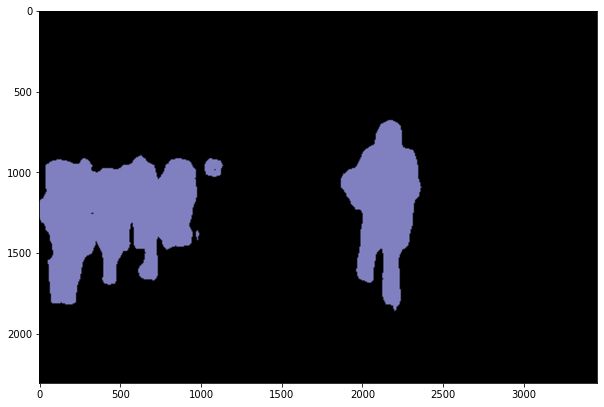

image 2:


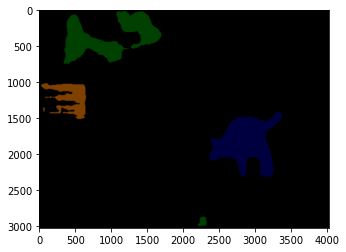

In [62]:
# semantic segmentation 결과 확인
plt.figure(figsize=(10, num_cols * 10))

for i, output in enumerate(output_list):
    print(f'image {i+1}:')
    plt.imshow(output)
    plt.show()

- 두번째 고양이 사진은 세로사진이 가로사진으로 바뀌어서 나왔다. 
- 어쨌든 모두 segment가 되었다. 
- 여기에서 `사람: 15` 색상과 `고양이 : 8` 색상을 뽑아내면 된다


---


## `output` 색상으로 배경과 피사체 분리
### 컬러맵 만들기

In [11]:
# 아래 코드를 이해하지 않아도 좋습니다
# PixelLib에서 그대로 가져온 코드입니다
# 주목해야 할 것은 생상 코드 결과물이예요!

#컬러맵 만들기 
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[:20] #생성한 20개의 컬러맵 출력

array([[  0,   0,   0],
       [128,   0,   0],
       [  0, 128,   0],
       [128, 128,   0],
       [  0,   0, 128],
       [128,   0, 128],
       [  0, 128, 128],
       [128, 128, 128],
       [ 64,   0,   0],
       [192,   0,   0],
       [ 64, 128,   0],
       [192, 128,   0],
       [ 64,   0, 128],
       [192,   0, 128],
       [ 64, 128, 128],
       [192, 128, 128],
       [  0,  64,   0],
       [128,  64,   0],
       [  0, 192,   0],
       [128, 192,   0]])

In [51]:
#컬러맵 15, 8에 해당하는 배열 출력 (pacalvoc에 LABEL_NAMES 15번째: 사람, 8번쨰: 고양이)
colormap[15], colormap[8]

(array([192, 128, 128]), array([64,  0,  0]))

- `ouput` 이미지는 BGR 순서로 채널 배치
- `colormap`는 RGB 순서

In [53]:
# 색상 순서 변경
seg_colors=[(128, 128, 192), (0, 0, 64)]

image 1 : (2304, 3456)


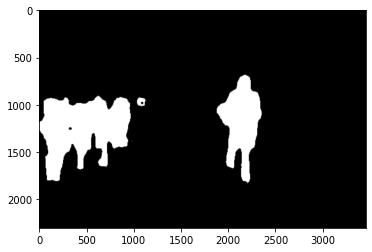

image 2 : (3024, 4032)


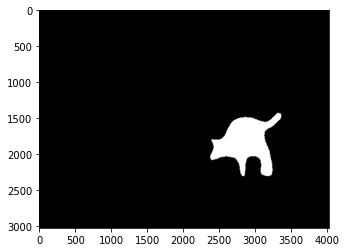

In [66]:
# output의 픽셀 별로 색상이 seg_color와 같다면 1(True), 다르다면 0(False)이 됩니다
# seg_color 값이 person을 값이 므로 사람이 있는 위치를 제외하고는 gray로 출력
# cmap 값을 변경하면 다른 색상으로 확인이 가능함

# seg_map담을 리스트
# seg_maps = []
# for i, seg_color in enumerate(seg_colors):
#     seg_maps.append(np.all(output_list[i]==seg_color, axis=-1))
#     print(f'image {i+1} : {seg_map[i].shape}') 
#     plt.imshow(seg_maps[i], cmap='gray')
#     plt.show()

👉 *Fix the problem*
- 고양이 사진이 가로로 바뀐채로 이후 작업을 이어가려고했는데, 원본사진과 합치는 과정에서 제대로 고양이 모양이 겹치게 하는게 어려웠다.
- 고양이 사진만 시계방향으로 90도 회전시키는 것으로 수정

---

💡 `numpy.rot90(m, k=1, axes=(0, 1))`
- 넘파이배열을 **반시계방향으로 90도씩 회전**시킨다
    - parameter `k` : Number of times the array is rotated by 90 degrees
- 시계방향으로 90도 회전시켜야하기때문에 `k=-1`로 설정한다<br>
[numpy doc](https://numpy.org/doc/stable/reference/generated/numpy.rot90.html), [blog](https://jimmy-ai.tistory.com/320)

---

image 1 : (2304, 3456)


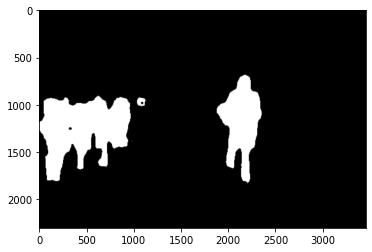

image 2 : (4032, 3024)


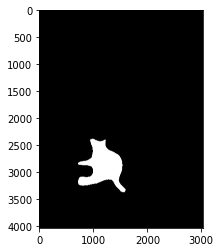

In [80]:
# 고양이 사진이 가로로 바뀌어 출력되어서 고양이 사진만 90도 회전
seg_maps = []
for i, seg_color in enumerate(seg_colors):
    seg_maps.append(np.all(output_list[i]==seg_color, axis=-1))
    if i == 1:
        seg_maps[i] = np.rot90(seg_maps[i], k=-1)  # Rotate 90 degrees
    print(f'image {i+1} : {seg_maps[i].shape}') 
    plt.imshow(seg_maps[i], cmap='gray')
    plt.show()

In [84]:
for i, img_orig in enumerate(img_origs):
    # 원본이미지를 img_show에 할당한뒤 이미지 사람이 있는 위치와 배경을 분리해서 표현한 color_mask 를 만든뒤 두 이미지를 합쳐서 출력
    img_show = img_orig.copy()
    print(img_show.shape)

(2304, 3456, 3)
(4032, 3024, 3)


## 3. 원래 이미지와 겹쳐서 보기

image 1


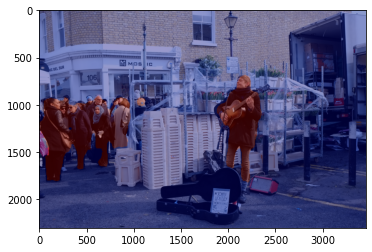

image 2


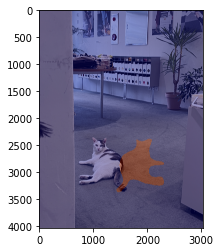

In [77]:
# for i, img_orig in enumerate(img_origs):
#     # 원본이미지를 img_show에 할당한뒤 이미지 사람이 있는 위치와 배경을 분리해서 표현한 color_mask 를 만든뒤 두 이미지를 합쳐서 출력
#     img_show = img_orig.copy()
    
#     if i == 1:
#         seg_maps[i] = seg_maps[i].T
    
#     # True과 False인 값을 각각 255과 0으로 바꿔줍니다
#     img_mask = seg_maps[i].astype(np.uint8) * 255
    

#     # 255와 0을 적당한 색상으로 바꿔봅니다
#     color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)

#     # 원본 이미지와 마스트를 적당히 합쳐봅니다
#     # 0.6과 0.4는 두 이미지를 섞는 비율입니다.
#     img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)
    
#     print(f'image {i+1}')
#     plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
#     plt.show()

image 1


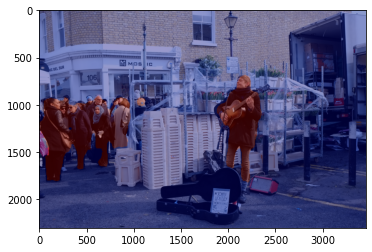

image 2


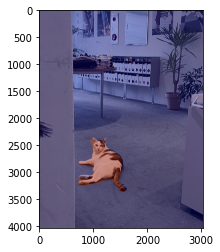

In [85]:
for i, img_orig in enumerate(img_origs):
    # 원본이미지를 img_show에 할당한뒤 이미지 사람이 있는 위치와 배경을 분리해서 표현한 color_mask 를 만든뒤 두 이미지를 합쳐서 출력
    img_show = img_orig.copy()
    
    # True과 False인 값을 각각 255과 0으로 바꿔줍니다
    img_mask = seg_maps[i].astype(np.uint8) * 255
    

    # 255와 0을 적당한 색상으로 바꿔봅니다
    color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)

    # 원본 이미지와 마스트를 적당히 합쳐봅니다
    # 0.6과 0.4는 두 이미지를 섞는 비율입니다.
    img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)
    
    print(f'image {i+1}')
    plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
    plt.show()

- 고양이 문제는 해결!

---

👉 *Fix the problem*
- 이제 두번째 문제가 남았다. 나는 첫번째 사진에서 가운데 기타들고 있는 사람만 뽑아낼거기때문에 주변에 있는 사람은 선택에서 제외해야한다.


**[해결 과정]**
- 기타들고 있는 사람의 x축 값을 활용해서 사람이 있는 지점만 선택(가운데사람만1, 주변 사람은 0)하는 mask를 생성
- 이걸 그림에 곱해서 저 부분만 1, 나머지는 0이 되도록 변경

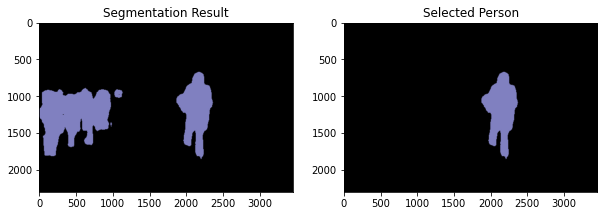

In [86]:
# Create a mask for the specified x-axis range
mask = np.zeros_like(output_list[0]) # 첫번째 그림이랑 동일한 사이즈의 mask 생성
mask[:, 1800:2500] = 1  # 사람있는 픽셀만 1로 변경 : x축의 대략 18000~2500 구간

# Apply the mask to the output 1
selected_person = output_list[0] * mask

# Display the segmentation result(output 1) and the selected person
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(output_list[0])
plt.title('Segmentation Result')

plt.subplot(1, 2, 2)
plt.imshow(selected_person)
plt.title('Selected Person')

plt.show()

- 잘 선택 되었다!
- 이 `selected person`값을 활용해서 다시 후반 과정을 반복

image 1 : (2304, 3456)


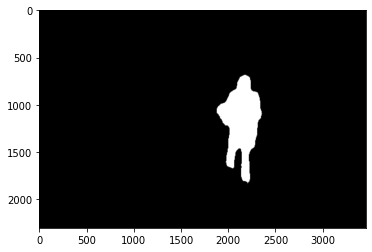

In [87]:
# seg_color로만 이루어진 마스크 생성

# selected_person의 픽셀별로 색상이 seg_color와 같다면 1(True), 다르다면 0(False)이 됩니다
# seg_color 값이 person을 값이 므로 사람이 있는 위치를 제외하고는 gray로 출력
# cmap 값을 변경하면 다른 색상으로 확인이 가능함

# 첫번째 이미지에 해당하는 seg_maps 값 수정
seg_maps[0] = np.all(selected_person==seg_colors[0], axis=-1) 
print(f'image 1 : {seg_maps[0].shape}') 
plt.imshow(seg_maps[0], cmap='gray')
plt.show()

image 1


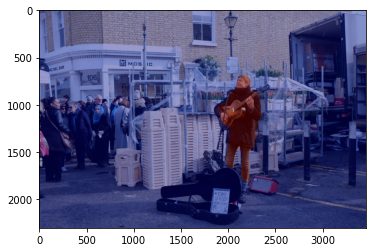

image 2


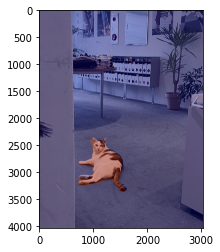

In [92]:
# 다시 원본이미지에 selected person 결합해서 출력
# img_mask 값도 이후에 필요해서 코드 추가 수정
img_masks = []
for i, img_orig in enumerate(img_origs):
    # 원본이미지를 img_show에 할당한뒤 이미지 사람이 있는 위치와 배경을 분리해서 표현한 color_mask 를 만든뒤 두 이미지를 합쳐서 출력
    img_show = img_orig.copy()
    
    # True과 False인 값을 각각 255과 0으로 바꿔줍니다
    img_masks.append(seg_maps[i].astype(np.uint8) * 255)
    

    # 255와 0을 적당한 색상으로 바꿔봅니다
    color_mask = cv2.applyColorMap(img_masks[i], cv2.COLORMAP_JET)

    # 원본 이미지와 마스트를 적당히 합쳐봅니다
    # 0.6과 0.4는 두 이미지를 섞는 비율입니다.
    img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)
    
    print(f'image {i+1}')
    plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
    plt.show()

- 모두 잘 적용되었다!

# 4. 배경 흐리게 하기

**`cv2.blur()`**
- blurring kernel size : (13,13)
- 다양하게 바꿔볼수 있음


**`cv2.cvtColor(input img, 색상 변환 코드)`**
- 입력 이미지의 색상 채널 변경 
- 원본이 BGR 순서로 픽셀을 읽기 때문에 RGB 형식으로 변경해야함 : `cv2.COLOR_BGR2RGB`
    - PixelLib가 BGR 순서로 픽셀을 반환
    
> **pixels in BGR (Blue, Green, Red) order**<br>
This is a common order for representing color images in many computer vision libraries and frameworks, including OpenCV, which is often used in conjunction with PixelLib (src:chatGPT)

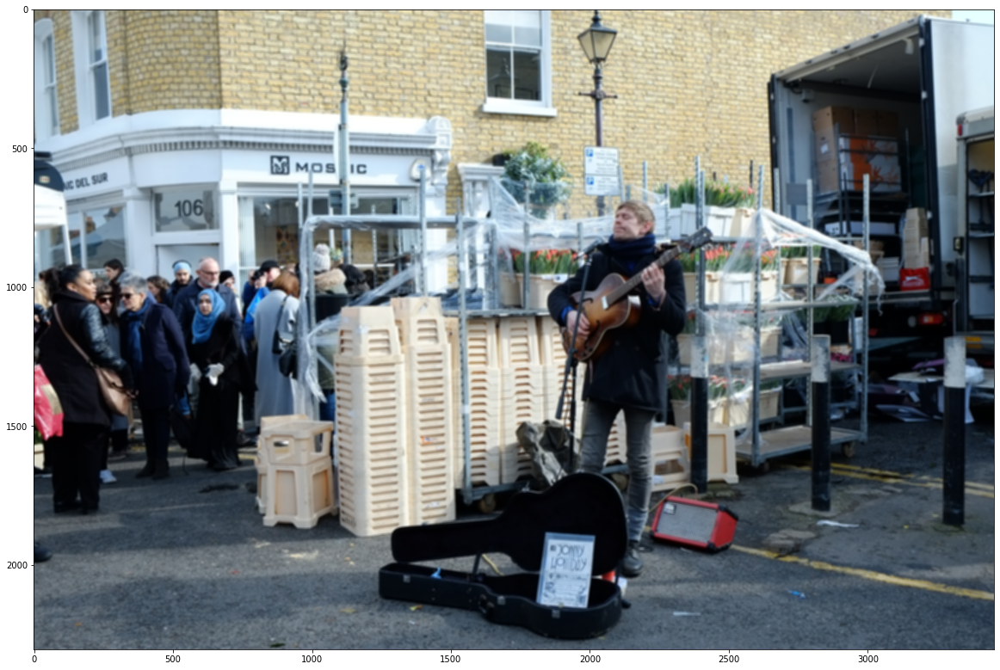

In [89]:
# 첫번째 사진 먼저 확인

# blurring - 10x10
img_orig_blur = cv2.blur(img_origs[0], (10,10))

# Set the size of the figure
plt.figure(figsize=(20, 15))

plt.imshow(cv2.cvtColor(img_orig_blur, cv2.COLOR_BGR2RGB))

plt.show()

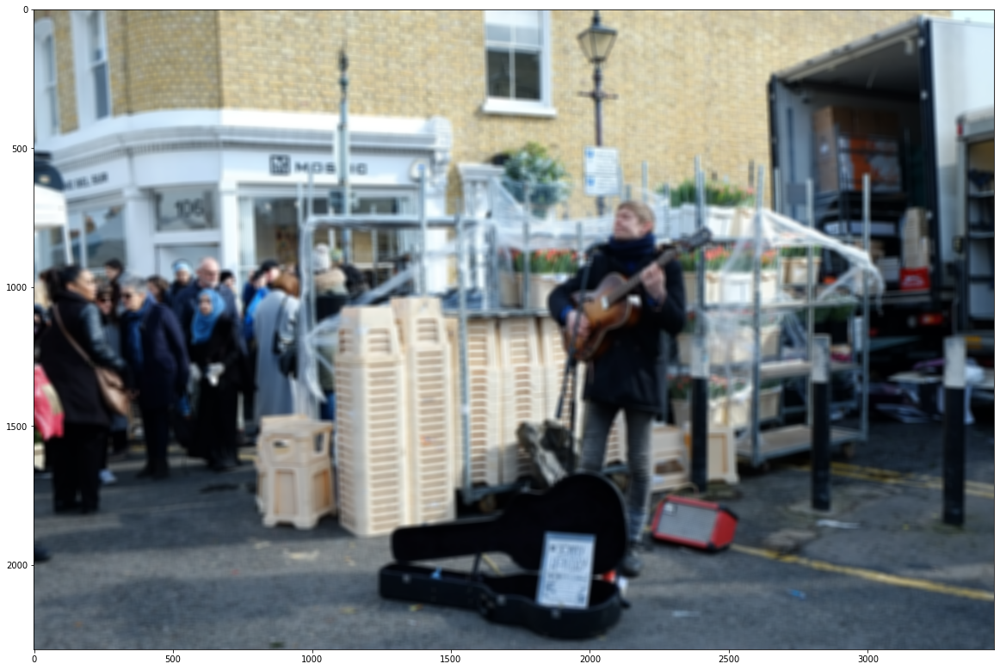

In [90]:
# blurring - 20x20
img_orig_blur = cv2.blur(img_origs[0], (20,20))

# Set the size of the figure
plt.figure(figsize=(20, 15))

plt.imshow(cv2.cvtColor(img_orig_blur, cv2.COLOR_BGR2RGB))

plt.show()

- kernel size가 클수록 블러링 효과가 강해진다
- 20x20 사이즈로 블러를 진행!

image 1


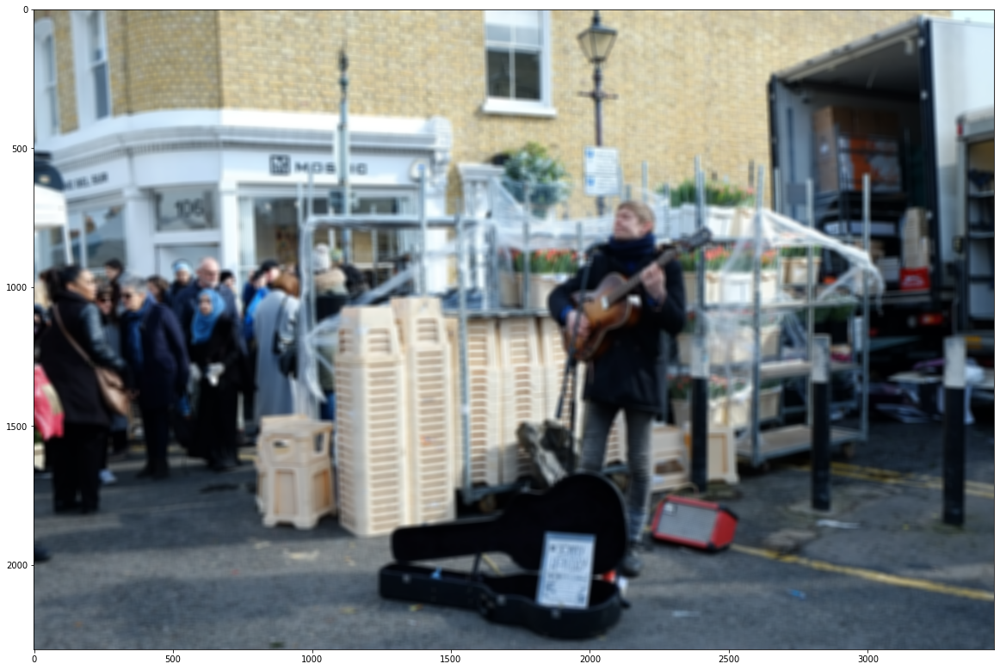

image 2


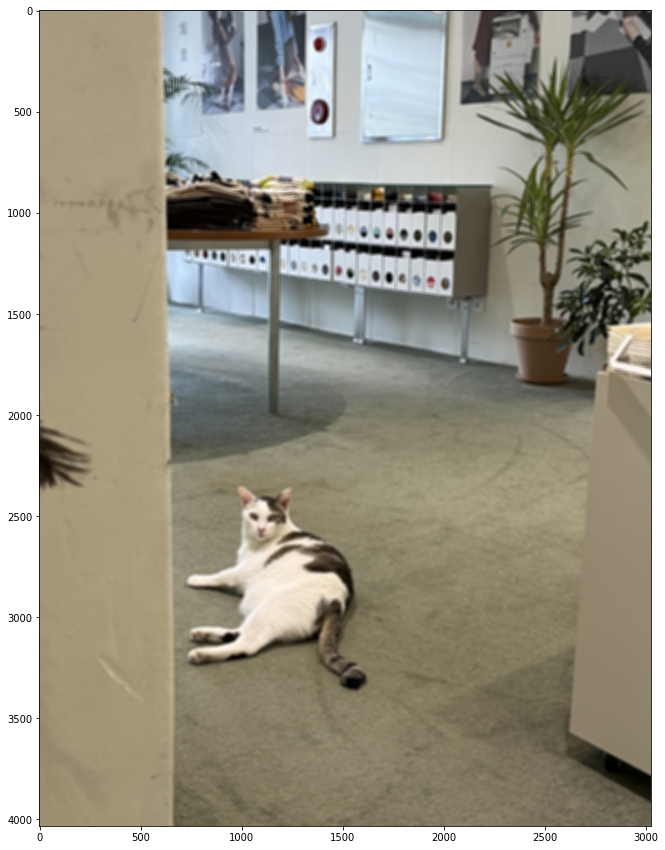

In [91]:
# 2개 이미지 블러 적용
# blurring - 20x20
img_orig_blurs = []

for i, img_orig in enumerate(img_origs):
    img_orig_blurs.append(cv2.blur(img_orig, (20,20)))

    # Set the size of the figure
    plt.figure(figsize=(20, 15))
    
    print(f'image {i+1}')
    plt.imshow(cv2.cvtColor(img_orig_blurs[i], cv2.COLOR_BGR2RGB))
    plt.show()

---
## 흐려진 이미지에서 segmentation mask를 이용해서 배경만 추출

[참고]
[blog](https://www.pyimagesearch.com/2021/01/19/opencv-bitwise-and-or-xor-and-not/)<br>
[blog](https://velog.io/@dldndyd01/OpenCV-bitwiseand-or-xor-not-%EA%B8%B0%EB%8A%A5-%EC%A0%95%EB%A6%AC-RGB-Image)<br>

**`bitwise_not()`**
- NOT funciton flips pixel values : mask영역에서 보색 출력
```python
# mask 1개 입력
cv2.bitwise_not(img_mask_color)
```

**`bitwise_and()`**
- mask 영역에서 서로 공통으로 겹치는 부분 출력
```python
# mask 2개 입력
cv2.bitwise_and(img_orig_blur, img_bg_mask)
```

image 1


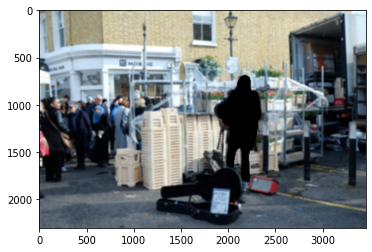

image 2


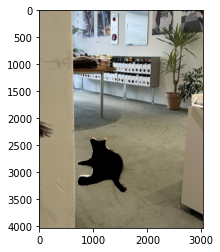

In [94]:
# img_mask_color 생성
img_mask_colors = []

for i, img_orig_blur in enumerate(img_orig_blurs):
    # 이미지 색상 채널을 변경 (BGR 형식을 RGB 형식으로 변경) 
    img_mask_colors.append(cv2.cvtColor(img_masks[i], cv2.COLOR_GRAY2BGR))

    # cv2.bitwise_not(): 이미지가 반전됩니다. 배경이 0 사람이 255 였으나
    # 연산을 하고 나면 배경은 255 사람은 0입니다.
    img_bg_mask = cv2.bitwise_not(img_mask_colors[i])

    # cv2.bitwise_and()을 사용하면 배경만 있는 영상을 얻을 수 있습니다.
    # 0과 어떤 수를 bitwise_and 연산을 해도 0이 되기 때문에 
    # 사람이 0인 경우에는 사람이 있던 모든 픽셀이 0이 됩니다. 결국 사람이 사라지고 배경만 남아요!
    img_bg_blur = cv2.bitwise_and(img_orig_blurs[i], img_bg_mask)
    
    print(f'image {i+1}')
    plt.imshow(cv2.cvtColor(img_bg_blur, cv2.COLOR_BGR2RGB))
    plt.show()

# 5. 흐린 배경 + 원본 영상 합성

- [np.where(조건, 참일때, 거짓일때)](https://numpy.org/doc/stable/reference/generated/numpy.where.html)

image 1


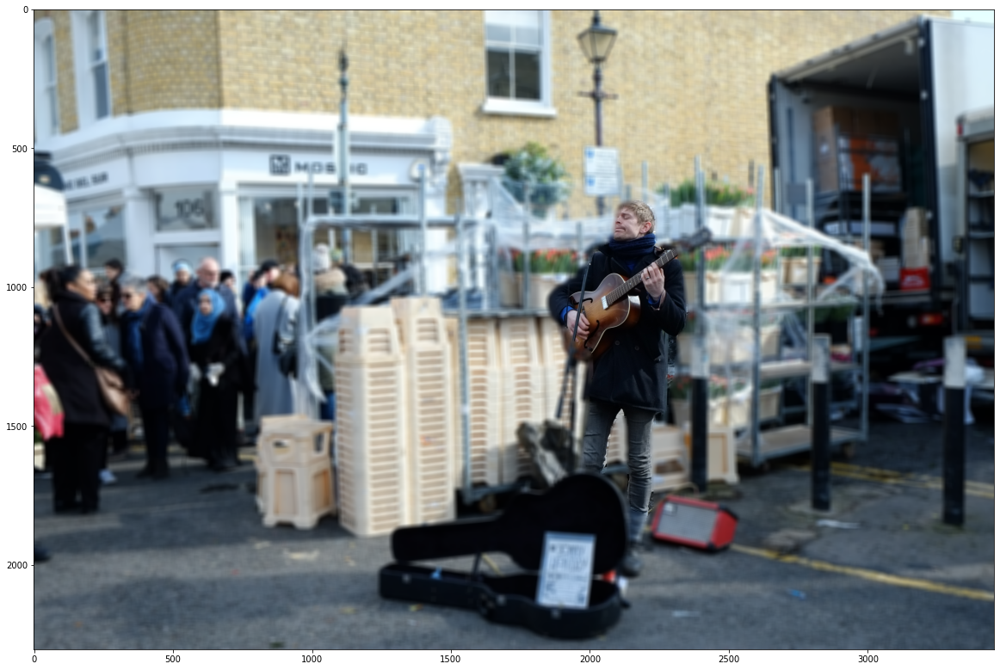

image 2


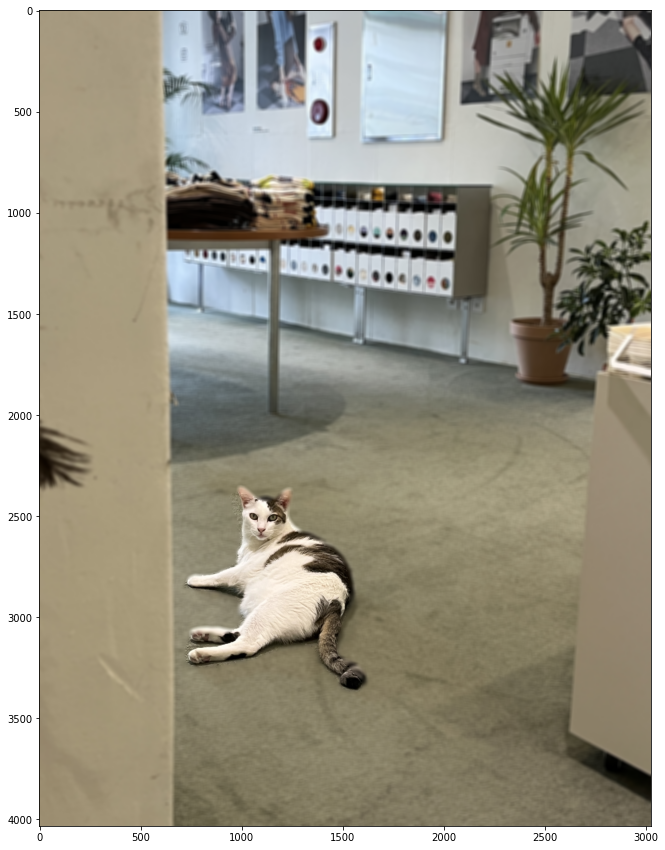

In [95]:
for i, img_orig in enumerate(img_origs):
    # seg mask가 255인 부분만 원본 이미지 값을 가져오고
    # 아닌 영역은 블러 이미지 값을 가져옴
    img_concat = np.where(img_mask_colors[i]==255, img_orig, img_orig_blurs[i])

    # Set the size of the figure
    plt.figure(figsize=(20, 15))
    
    print(f'image {i+1}')
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.show()

image 1


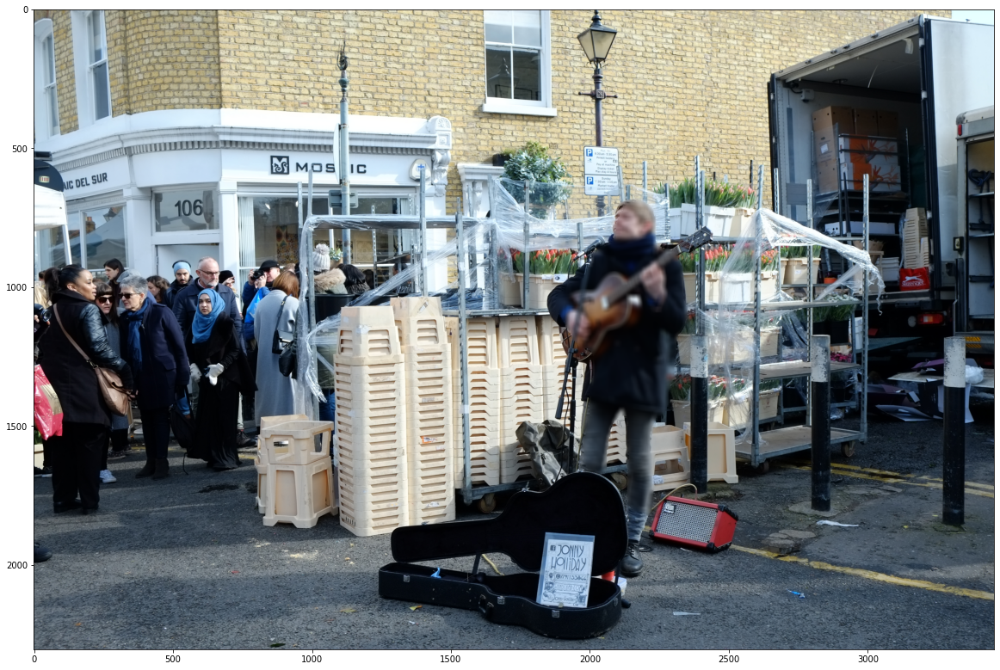

image 2


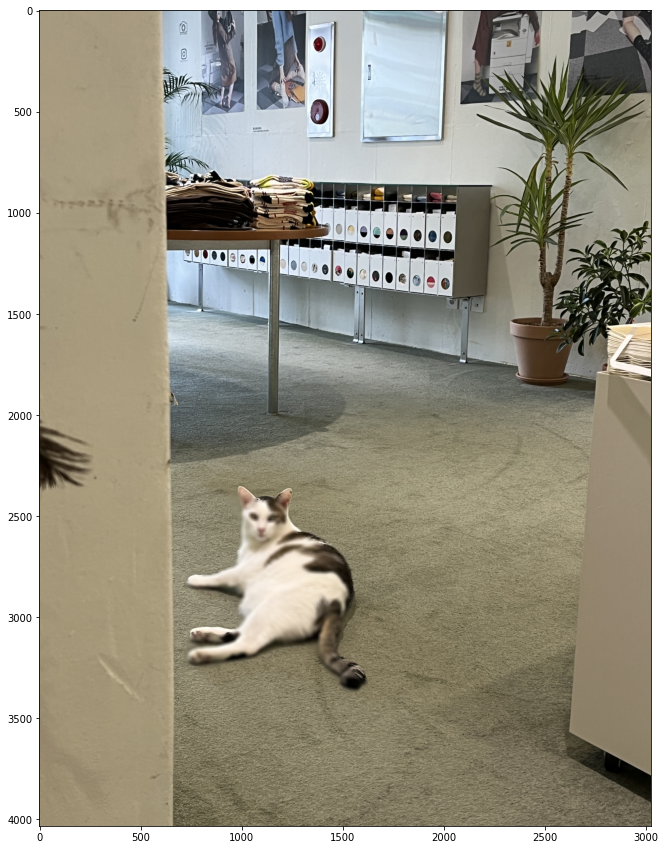

In [98]:
# blur 반대로
for i, img_orig in enumerate(img_origs):
    # seg mask가 255인 부분만 원본 이미지 값을 가져오고
    # 아닌 영역은 블러 이미지 값을 가져옴
    rev_img_concat = np.where(img_mask_colors[i] != 255, img_orig, img_orig_blurs[i])

    # Set the size of the figure
    plt.figure(figsize=(20, 15))
    
    print(f'image {i+1}')
    plt.imshow(cv2.cvtColor(rev_img_concat, cv2.COLOR_BGR2RGB))
    plt.show()

# 6. 배경전환 크로마키 사진 제작
**꽃밭에서 노래하는 사람 사진**을 만들어본다
- 영화 `Big fish`의 한 장면을 가져와서 주인공들 옆에서 감미로운 노래를 불러주면 멋질것 같다.

**[방법]**
- 위에서 내가 원하는 피사체 부분만을 표시한 `seg_map`을 활용하면 쉽게 배경에 다른 이미지를 삽입할수 있을것같다.
- [지난 기수 그루의 코드](https://github.com/HRPzz/AIFFEL/blob/main/EXPLORATION/Node_07/%5BE-07%5D%20make_a_portrait.ipynb)를 참고해서 진행!

---

💡 [`np.all()`](https://numpy.org/doc/stable/reference/generated/numpy.all.html)
- 배열의 모든 원소가 참인지 평가하는 함수
- `axis=-1` : 마지막 축<br>
[참고 blog](https://sparrow.dev/numpy-all/)

In [99]:
# Example data
output_list = [np.array([[[255, 0, 0], [0, 255, 0]], [[0, 0, 255], [255, 255, 0]]])]
seg_color = np.array([0, 255, 0])
output_list

[array([[[255,   0,   0],
         [  0, 255,   0]],
 
        [[  0,   0, 255],
         [255, 255,   0]]])]

- 이런 이미지가 있다고 가정할때 위의 seg_color 마스크로 boolean을 확인하면 아래와 같은 결과가 나온다

In [100]:
# Applying the logic explained above
seg_map = np.all(output_list[0] == seg_color, axis=-1)

print(seg_map)

[[False  True]
 [False False]]


- 아직 정확하게 이미지 픽셀의 배열이 눈에 그려지지 않지만, 이렇게 마스크가 돌면서 True로 변환시킨 부분에만 object가 위치한다고 생각하면 된다.

---

In [5]:
# 배경이미지 불러오기
back_img_path = './project_segmentation/images/Big_fish_daffodils.jpg'
back_img_orig = cv2.imread(back_img_path)
print(back_img_orig.shape)

(703, 1250, 3)


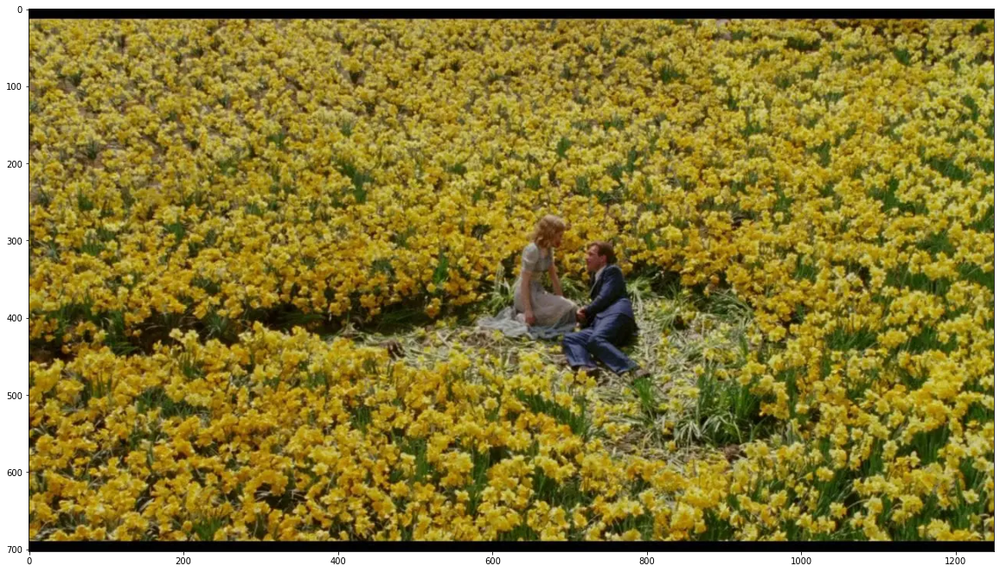

In [6]:
# 배경이미지 출력
plt.figure(figsize=(20, 15))
plt.imshow(cv2.cvtColor(back_img_orig, cv2.COLOR_BGR2RGB))
plt.show()

## 사람 object 만 추출

(2304, 3456, 3)


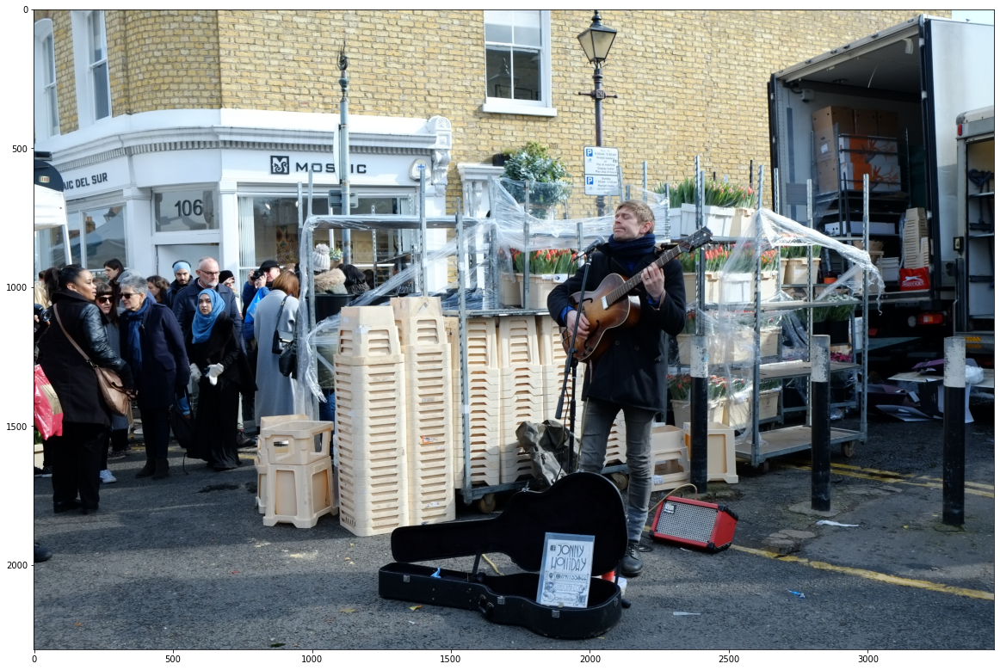

In [7]:
# 사람이미지 불러오기
person_img_path = './project_segmentation/images/my_image.jpg'
person_img_orig = cv2.imread(person_img_path)
print(person_img_orig.shape)

# 사람이미지 출력
plt.figure(figsize=(20, 15))
plt.imshow(cv2.cvtColor(person_img_orig, cv2.COLOR_BGR2RGB))
plt.show()

## 사람 segment 만들기

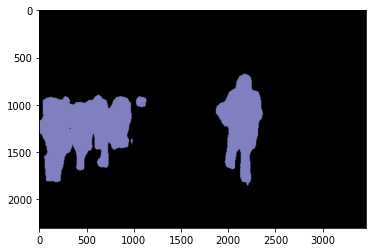

In [10]:
# segmentAsPascalvoc()함수를 호출하여 입력된 이미지를 분할, 분할 출력의 배열을 가져옴, 분할 은 pacalvoc 데이터로 학습된 모델을 이용
segvalues, output = model.segmentAsPascalvoc(person_img_path) 

# semantic segmentation 결과 확인
#segmentAsPascalvoc() 함수 를 호출하여 입력된 이미지를 분할한 뒤 나온 결과값 중 output을 matplotlib을 이용해 출력
plt.imshow(output)
plt.show()

In [12]:
# 색상 순서 변경
seg_color=(128, 128, 192)

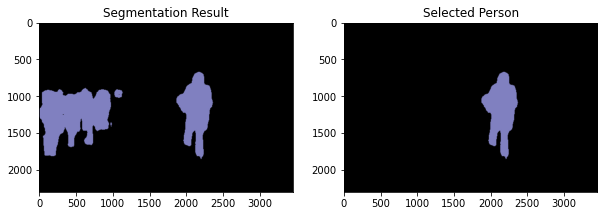

In [13]:
# Create a mask for the specified x-axis range
mask = np.zeros_like(output)
mask[:, 1800:2500] = 1  # Set the pixels in the specified x-axis range to 1

# Apply the mask to the output
selected_person = output * mask

# Display the segmentation result(output) and the selected person
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(output)
plt.title('Segmentation Result')

plt.subplot(1, 2, 2)
plt.imshow(selected_person)
plt.title('Selected Person')

plt.show()

(2304, 3456)


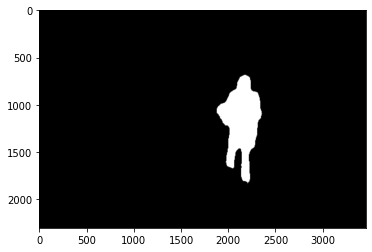

In [14]:
# seg_color로만 이루어진 마스크 생성

# selected_person의 픽셀별로 색상이 seg_color와 같다면 1(True), 다르다면 0(False)이 됩니다
# seg_color 값이 person을 값이 므로 사람이 있는 위치를 제외하고는 gray로 출력
# cmap 값을 변경하면 다른 색상으로 확인이 가능함
seg_map = np.all(selected_person==seg_color, axis=-1) 
print(seg_map.shape) 
plt.imshow(seg_map, cmap='gray')
plt.show()

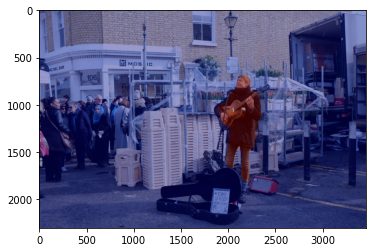

In [16]:
# 다시 원본이미지에 selected person 결합해서 출력
# 원본이미지를 img_show에 할당한뒤 이미지 사람이 있는 위치와 배경을 분리해서 표현한 color_mask 를 만든뒤 두 이미지를 합쳐서 출력
img_show = person_img_orig.copy()

# True과 False인 값을 각각 255과 0으로 바꿔줍니다
img_mask = seg_map.astype(np.uint8) * 255

# 255와 0을 적당한 색상으로 바꿔봅니다
color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)

# 원본 이미지와 마스트를 적당히 합쳐봅니다
# 0.6과 0.4는 두 이미지를 섞는 비율입니다.
img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)

plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
plt.show()

## 이미지에서 object 제외한 배경만 추출

(2304, 3456, 3)


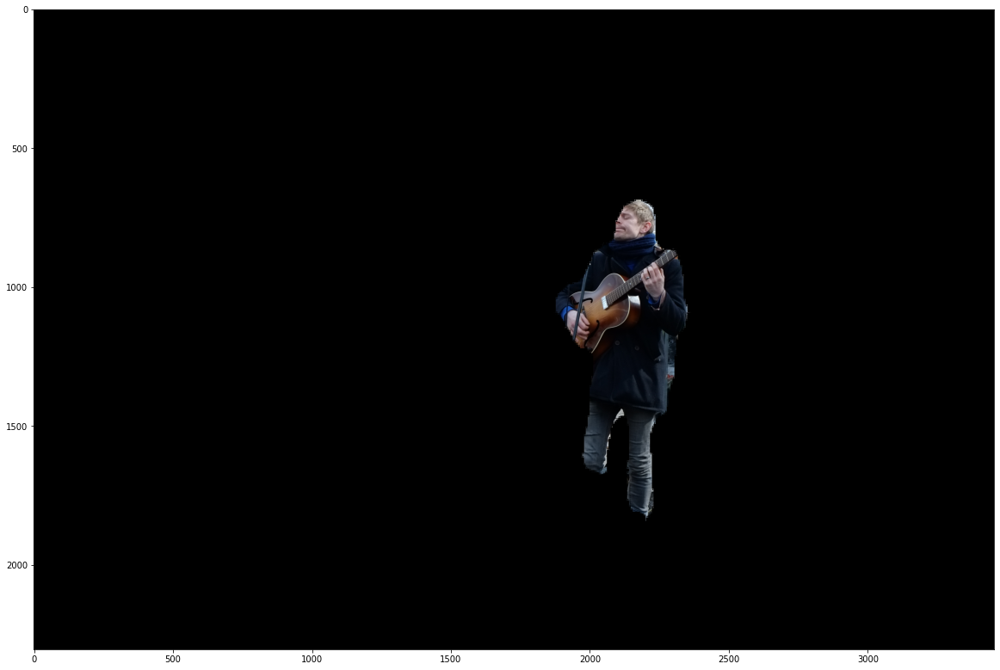

In [18]:
# 이미지 색상 채널을 변경 (BGR 형식을 RGB 형식으로 변경) 
img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)

# 사람만 남기고 나머지는 0(검은색) 처리
# index 0이 사람 사진에 대한 값들
person_img_concat = np.where(img_mask_color==255, person_img_orig, 0)

# Set the size of the figure
plt.figure(figsize=(20, 15))

print(person_img_concat.shape)
plt.imshow(cv2.cvtColor(person_img_concat, cv2.COLOR_BGR2RGB))
plt.show()

## 사람 사진 크기 변경

---

💡 `cv2.resize(src, dsize, dst=None, fx=None, fy=None, interpolation=None)`[opencv doc](https://docs.opencv.org/4.9.0/da/d54/group__imgproc__transform.html#ga47a974309e9102f5f08231edc7e7529d)
- src: 입력 영상
- dsize: 결과 영상 크기
    - (w, h) 튜플
    - (0, 0)이면 fx와 fy 값을 이용하여 결정
- fx, fy: x와 y방향 스케일 비율(scale factor)
    - dsize 값이 0일 때 유효
- **interpolation**: 보간법 지정
    - 기본값은 cv2.INTER_LINEAR
    - 이 값을 잘 설정하는게 중요

<img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FcUnvib%2FbtqKfpVJx0L%2FAxLwwDND0IuXDmqkOR5lI0%2Fimg.png'>

1. cv2.INTER_NEAREST - 최근방 이웃 보간법
    - 가장 빠르지만 퀄리티가 많이 떨어져서 잘 사용하지 않음


2. cv2.INTER_LINEAR - 양선형 보간법(2x2 이웃 픽셀 참조)
    - 4개의 픽셀을 이용
    - 효율성이 가장 좋음: 속도도 빠르고 퀄리티도 적당


3. cv2.INTER_CUBIC - 3차회선 보간법(4x4 이웃 픽셀 참조)
    - 16개의 픽셀을 이용합니다.
    - cv2.INTER_LINEAR 보다 느리지만 퀄리티는 더 좋음


4. cv2.INTER_LANCZOS4 - Lanczos 보간법 (8x8 이웃 픽셀 참조)
    - 64개의 픽셀을 이용
    - 좀더 복잡해서 오래 걸리지만 퀄리티는 좋음


5. cv2.INTER_AREA - 영상 축소시 효과적
    - 영역적인 정보를 추출해서 결과 영상을 셋팅
    - 영상을 축소할 때 이용

[참고 blog](https://deep-learning-study.tistory.com/185) 

---

- 내용이 매우 복잡하지만 일단 블로그와 그루 코드를 참고로 사람 사진을 줄여본다
- 배경사진에서 사람이 대략 100px 크기였기때문에 이거에 맞춰서 사진을 줄인다

(329, 493, 3)


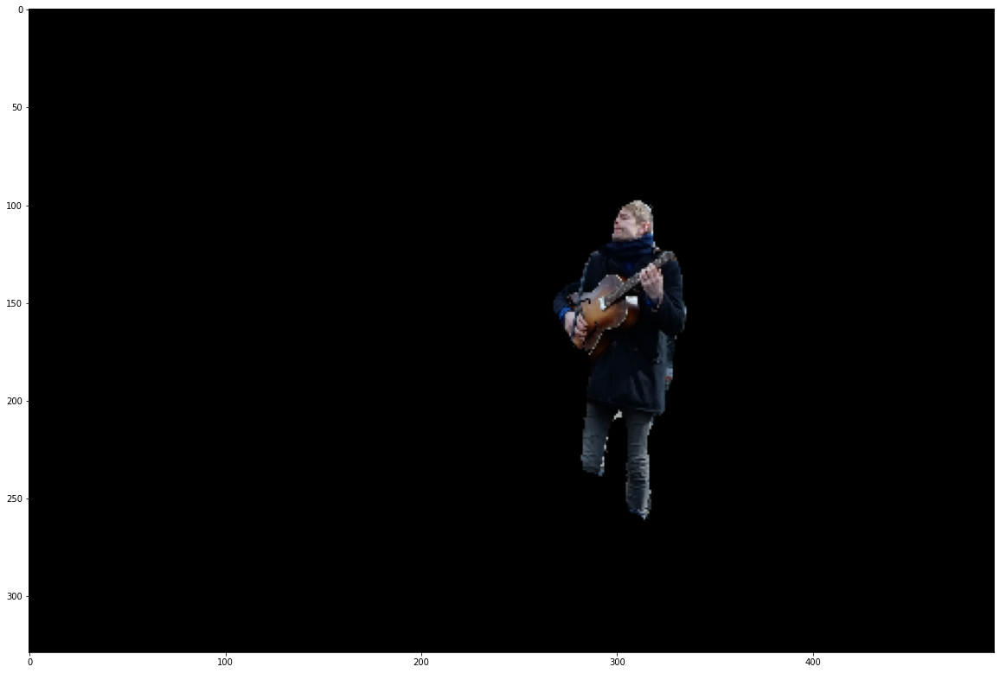

In [24]:
# 사람 resize
h, w, c = person_img_concat.shape
person_img_resize = cv2.resize(person_img_concat, (w//7, h//7), cv2.INTER_NEAREST)

# Set the size of the figure
plt.figure(figsize=(20, 15))

print(person_img_resize.shape)
plt.imshow(cv2.cvtColor(person_img_resize, cv2.COLOR_BGR2RGB))
plt.show()

## 배경이미지와 사람 이미지 합성

(703, 1250, 3)


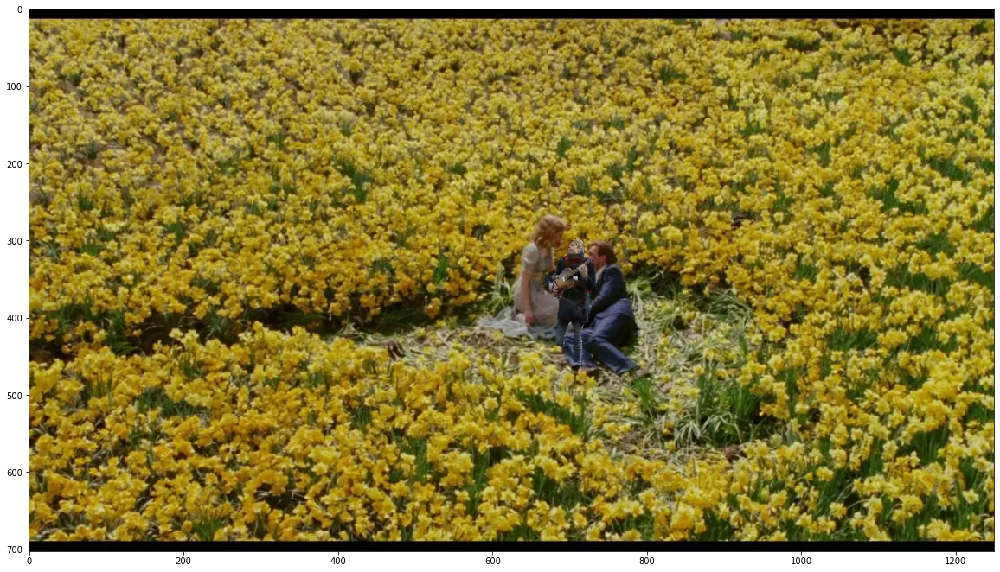

In [25]:
back_img_show = back_img_orig.copy()

refined_y = 200
refined_x = 400

alpha = 0.2  # 투명도
alpha = 0.2  # 투명도
sticker_area = back_img_show[refined_y:refined_y + person_img_resize.shape[0], 
                             refined_x:refined_x+person_img_resize.shape[1]]
back_img_show[refined_y:refined_y + person_img_resize.shape[0], 
              refined_x:refined_x+person_img_resize.shape[1]] = \
cv2.addWeighted(sticker_area, alpha, 
                np.where(person_img_resize==0, sticker_area, person_img_resize).astype(np.uint8),
                1-alpha, 0)  # 컬러 값 0(검은색)

plt.figure(figsize=(20, 15))
print(back_img_show.shape)
plt.imshow(cv2.cvtColor(back_img_show, cv2.COLOR_BGR2RGB))
plt.show()

- 어떻게 이렇게 딱 가운데에 서서 노래를 하시게 되었지!
- 사람 object 크기를 조금 더 키우고, 위치를 오른쪽으로 조정해보자

## 사람 사진 크기 변경 2

(768, 1152, 3)


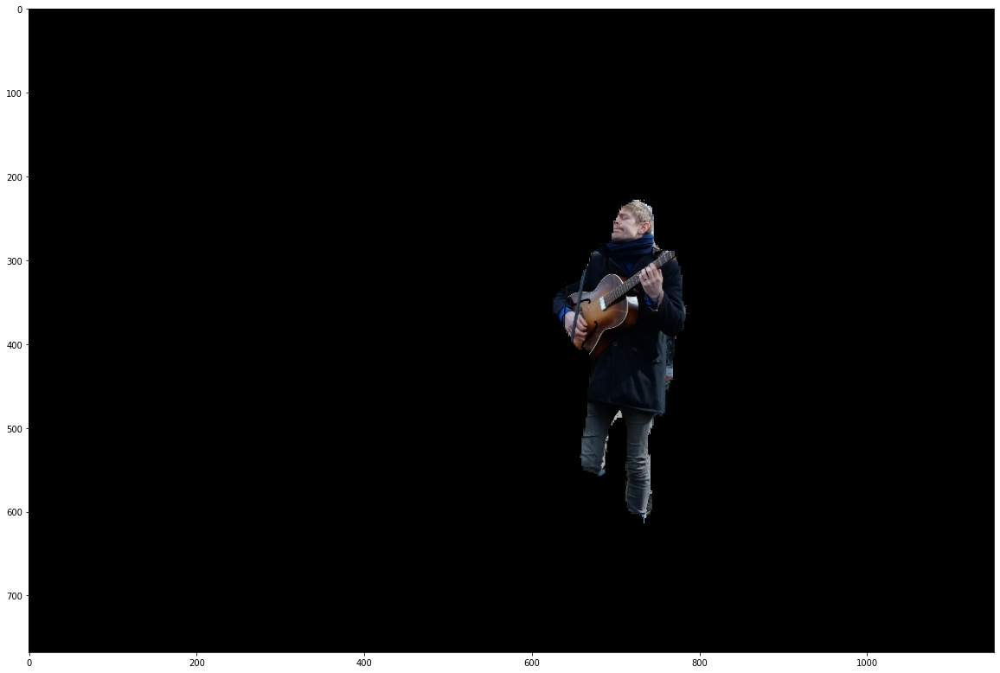

In [32]:
# 사람 resize 2
h, w, c = person_img_concat.shape
person_img_resize2 = cv2.resize(person_img_concat, (w//3, h//3),  # 7 -> 3
                               cv2.INTER_LINEAR) # 효율성이 가장 높다고 말했던 방법으로 변경

# Set the size of the figure
plt.figure(figsize=(20, 15))

print(person_img_resize2.shape)
plt.imshow(cv2.cvtColor(person_img_resize2, cv2.COLOR_BGR2RGB))
plt.show()

## 배경이미지와 사람 이미지 합성 2
- 사람 이미지 w, h 값에 refined_x, refined_y 만큼이 더해진 지점에 사진이 위치한다
    - refined_y + person_img_resize.shape[0] / refined_x+person_img_resize.shape[1]
- 배경 이미지의 600, 900 지점에 위치하면 좋겠어서 아래와 같이 코드 수정

In [33]:
back_img_show = back_img_orig.copy()

refined_y = 300
refined_x = 500

alpha = 0.2  # 투명도

sticker_area2 = back_img_show[refined_y:refined_y + person_img_resize2.shape[0], 
                             refined_x:refined_x+person_img_resize2.shape[1]]
back_img_show[refined_y:refined_y + person_img_resize2.shape[0], 
              refined_x:refined_x + person_img_resize2.shape[1]] = \
cv2.addWeighted(sticker_area2, alpha, 
                np.where(person_img_resize2==0, sticker_area2, person_img_resize2).astype(np.uint8),
                1-alpha, 0)  # 컬러 값 0(검은색)

plt.figure(figsize=(20, 15))
print(back_img_show.shape)
plt.imshow(cv2.cvtColor(back_img_show, cv2.COLOR_BGR2RGB))
plt.show()

ValueError: operands could not be broadcast together with shapes (768,1152,3) (403,750,3) (768,1152,3) 

- `sticker_area`와 `person_img_resize`의 shape이 같아야한다고 한다.(위에서는 어떻게 맞았지..?)

In [34]:
print(f'1\n sticker_area.shape :{sticker_area.shape}, person_img_resize.shape :{person_img_resize.shape}')
print(f'2\n sticker_area2.shape :{sticker_area2.shape}, person_img_resize2.shape :{person_img_resize2.shape}')

1
 sticker_area.shape :(329, 493, 3), person_img_resize.shape :(329, 493, 3)
2
 sticker_area2.shape :(403, 750, 3), person_img_resize2.shape :(768, 1152, 3)


- 와..? 의도했던건 아닌데 어떻게 딱 맞았었다. 신기하네..
- interpolation 값을 cv2.INTER_NEAREST -> cv2.INTER_LINEAR 로 변경해서 인가?
- 일단 둘의 shape을 맞춰준다

(703, 1250, 3)


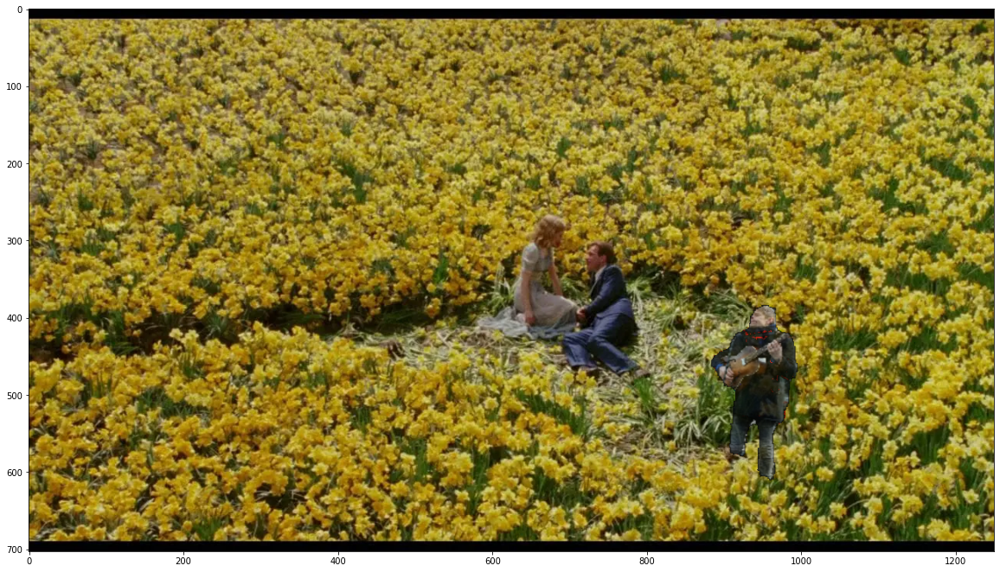

In [35]:
back_img_show = back_img_orig.copy()

refined_y = 250
refined_x = 450

alpha = 0.2  # 투명도

sticker_area2 = back_img_show[refined_y:refined_y + person_img_resize2.shape[0], 
                             refined_x:refined_x + person_img_resize2.shape[1]]

# Ensure the person image has the same shape as sticker_area
person_img_resized = cv2.resize(person_img_resize, (sticker_area2.shape[1], sticker_area2.shape[0]))
 
back_img_show[refined_y:refined_y + person_img_resized.shape[0], 
              refined_x:refined_x + person_img_resized.shape[1]] = \
    cv2.addWeighted(sticker_area2, alpha, 
                    np.where(person_img_resized == 0, sticker_area2, person_img_resized).astype(np.uint8),
                    1 - alpha, 0)  # 컬러 값 0(검은색)

plt.figure(figsize=(20, 15))
print(back_img_show.shape)
plt.imshow(cv2.cvtColor(back_img_show, cv2.COLOR_BGR2RGB))
plt.show()

- 완성
- 감미로운 음악을 들려주고 계시겠징..💗

# Step 2. Segmentation 문제점 찾기

## 작업한 사진 저장
- OpenCV 로 읽어들인 이미지를 다시 파일로 저장하는 함수 `cv2.imwrite()`를 이용

[matplotlib로 작업한 사진 저장-blog](https://gr-st-dev.tistory.com/812)
[OpenCV로 작업한 사진 저장-blog](https://diytube.tistory.com/18)

In [39]:
# segmentation 사진 저장
save_file = './project_segmentation/images/seg_person_img.jpg'

cv2.imwrite(save_file, cv2.cvtColor(person_img_concat, cv2.COLOR_BGR2RGB))

True

<img src='./seg_person_img.jpg'>

- 아저씨가 굉장히 창백하게 나온다... 빨간색이 제대로 표현이 안된것 같다.
- 어쨌든 분명하게 사진의 문제점이 보인다

---

<img src="my_image_orig.jpeg" alt="Original img" width=30% height=30%></td>
<img src="check_seg_person_img.png" alt="Segmented img"></td>

- 노란색 화살표와 박스친 부분을 보면 
    - 배경도 포함되어있어서 경계선 처리가 깔끔하지 못하거나, 
    - 과하게 object가 잘려나간걸 알수 있다. 

---

# Step 3. 해결방법 제안

- segmentation의 한계점을 보완하는 방법을 제시
> 단순히 'XXX 기술을 사용한다.' 정도의 선언적 솔루션이 아니라, 여러분들이 선택한 기술이 DeepLab 모델의 Semantic Segmentation 이 만들어 낸 Mask 영역에 어떻게 적용되어 문제점을 보완하게 되는지의 메커니즘이 포함된 솔루션이어야 합니다.
- 가능하면 flow chart를 활용

---

## 💡 관련자료


**✔️ Segmentation의 한계점**
- semantic segmentation 부정확성이 여러 문제를 발생시키는 원인
- 피사계심도를 이용한 보케(아웃포커싱) 효과는 '심도를 표현'하기때문에 초점이 잡힌 거리를 광학적으로 섬세하게 구별(segmentation)할수 있음
- 하지만 이 방식을 차용한 semantic segmentation 모듈은 정확도가 1.00 이 아닌이상 완벽히 구현하기 힘들다


**✔️ [피사계 심도](https://m.blog.naver.com/typs6301/222172333739)**
<img src='https://mblogthumb-phinf.pstatic.net/MjAyMDEyMTNfMTcy/MDAxNjA3ODQ3ODY3MjI0._ENMjo9KE4Ou8vflg2mr-5YJYY6kX-gLdYE5e2Kxf-kg.afo9uuvmle-9Xiq4ejY0X01qQaLBTwb0K_rfaADgB-Yg.JPEG.typs6301/IMG_7098.jpg?type=w800' width=70% height=70%>

- 피사계 심도 (depth of field, DOF) : 사진에서 초점이 맞은것으로 인식되는 범위
- 렌즈에서 초점이 맞는 거리(Focus Distance)는 한 부분 -> 초점면(Focus Point)
- 초점면을 중심으로 서서히 흐려지는 현상이 나타남
    - 초점이 맞은 범위가 '피사계 심도'!
- 아웃포커싱 = 피사계심도(심도)가 낮다/얕다 = Narrow/Short Depth of Field
- 전체적으로 포커스가 잘 맞음 = 심도가 깊다 = Large/Long Depth of Field



**✔️[Adobe 관련문서](https://www.adobe.com/kr/creativecloud/photography/discover/shallow-depth-of-field.html)**
> "**하나의 점을 강조하고 나머지 내용에 부드러운 흐림 효과를 줌**으로써 사진에 의미를 더하는 것입니다." <br>
> "**초점이 맞은 것에 집중하도록 하고 불필요한 결함은 모호하게 함**으로써 사진의 구도를 개선합니다."

- 참고자료들을 보면 결국 segmentation하려는 object의 윤곽선을 잘 잡아내야 원하는 기법을 잘 적용할수 있다.
- 윤곽선을 잘 잡아내려면 어떻게 해야할까?


**✔️ [3D Camera 활용하기](https://news.skhynix.co.kr/post/next-gen-3d)**
- 스테레오 비전, ToF 방식을 사용해서 이미지를 3D로 인식
- 3D 이미지 센서 : 사물까지의 거리(심도)를 측정해서 더 정밀하게 물체나 동작을 인식하고 3D 이미지로 구현
<img src='https://news.skhynix.co.kr/hs-fs/hubfs/B_NewsRoom/Technology(362)/%EB%B9%84%EC%A6%88%EB%8B%88%EC%8A%A4(90)/2021/0512/I-ToF%20%EB%B0%A9%EC%8B%9D%EC%9D%80%20%ED%8A%B9%EC%A0%95%20%EC%A3%BC%ED%8C%8C%EC%88%98%EB%A1%9C%20%EB%B3%80%EC%A1%B0%EB%90%9C%20%EB%A0%88%EC%9D%B4%EC%A0%80%EB%A5%BC%20%EC%9D%B4%EC%9A%A9%ED%95%B4%20%EB%AC%BC%EC%B2%B4%EB%A1%9C%EB%B6%80%ED%84%B0%20%EB%B0%98%EC%82%AC.jpg?width=945&name=I-ToF%20%EB%B0%A9%EC%8B%9D%EC%9D%80%20%ED%8A%B9%EC%A0%95%20%EC%A3%BC%ED%8C%8C%EC%88%98%EB%A1%9C%20%EB%B3%80%EC%A1%B0%EB%90%9C%20%EB%A0%88%EC%9D%B4%EC%A0%80%EB%A5%BC%20%EC%9D%B4%EC%9A%A9%ED%95%B4%20%EB%AC%BC%EC%B2%B4%EB%A1%9C%EB%B6%80%ED%84%B0%20%EB%B0%98%EC%82%AC.jpg' width=40% height=40%>

    
**✔️ 소프트웨어 기술 활용하기**
- 구글의 struct2Depth
    - [Unsupervised Learning of Depth and Ego-Motion: A Structured Approach](https://sites.google.com/view/struct2depth)
    

**✔️ 다른 기술과 융합**
- 구글 pixel4에는 IR(적외선)카메라(물체의 온도를 측정)가 달려있어서 보다 멋진 3d Depth sensing이 가능함
- [uDepth: Real-time 3D Depth Sensing on the Pixel 4](https://ai.googleblog.com/2020/04/udepth-real-time-3d-depth-sensing-on.html)

---

## 해결방안 도출 과정(생각정리)

- 참고자료에 있는 기술의 정확한 원리는 이해가 안되지만, 어쨌든 object의 윤곽을 잘 잡아내기위한 여러 시도로 귀결되는것 같다.
- supervised learning이 아닌 unsupervised learning을 적용한 기법은 더 신기하다.


### 📝 1. Semantic segmentation?
<img src='https://assets-global.website-files.com/614c82ed388d53640613982e/63f4cb5336f5182778f257c2_semantic%20segmentation%20idea%20fully%20convolutional.jpg' width=70% hegith=70%>
<figure>
    <img src='https://assets-global.website-files.com/614c82ed388d53640613982e/63f4a113480f95d70a11e2d2_fully%20convolutional%20neural%20network.jpg' width=70% hegith=70%>
    <figcaption style="text-align: center; font-style: italic;">The last layer of the convnet</figcaption>
</figure>

[src](https://www.superannotate.com/blog/guide-to-semantic-segmentation)

👉 convolution layer에서 **얼마나 자세하게 pixel간의 관계/정보를 알아내는가?** 가 중요한 지점이 아닐까

---
### 📝 2. [semantic segmentation 대회에서 사용하는 방법](https://modernflow.tistory.com/123)
semantic segmentation 대회에서 사용하는 방법을 정리한 블로그를 발견했는데 아래의 시도를 해본다고 한다.
- **image resize**
- **sliding window 조절**
<figure>
    <img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FoxluP%2FbtrinAC3qYj%2FxHzYtmQHGWjEBpk0QhMxIk%2Fimg.png' width=80% hegith=80%>
    <figcaption style="text-align: center; font-style: italic;">Sliding window(overlapping)</figcaption>
</figure>

---

<figure>
    <img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FbwPgX6%2FbtrikLeunlU%2FNn73BRx6OxoL2vfXzkGUR0%2Fimg.png' width=50% hegith=50%>
    <figcaption style="text-align: center; font-style: italic;">Sliding window(bigger size)</figcaption>
</figure>

---

<figure>
    <img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FcXf3k3%2FbtriiuYBQuN%2F7jJRoV7207jcYHZ3KWIfjK%2Fimg.png'>
    <figcaption style="text-align: center; font-style: italic;">Sliding window in cropped img</figcaption>
</figure>

---

- **segmentation/object detection + crop + resegmentation**
<figure>
    <img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FvgmZb%2FbtrionXI2jv%2FhmjGdoypTudhIARfBS90CK%2Fimg.png'>
    <figcaption style="text-align: center; font-style: italic;">Sliding window in cropped img</figcaption>
</figure>



    등의 방식을 활용한다.
    
👉 **3번 방식으로 object 부분을 먼저 찾고, 찾은 부분을 중심으로 crop한 뒤, 다시 해당 부분에 대해 segmentation을 진행하면 특징 추출을 더 정확하게 할수 있지 않을까?**<br>
👉 이런 방식을 적용한 모델이 있는지 찾아보던 중에 NLP에서 사용하는 Transformer를 CV에서도 사용한다는걸 발견했다

---

### 📝  3. Vision Transformer
- vision분야에서 사용하는 transformer를 [`ViT (Vision transformers)`](https://arxiv.org/pdf/2010.11929.pdf)라고 부른다

**Vision Transformer 특징** 
- **이미지를 Patch로 분할 후 Sequence로 입력** → NLP에서 단어(Word)가 입력되는 방식과 동일! 
- Transformer는 inductive biases가 없음 = Locality와 Translation Equivariance 같은 CNN의 특성이 없음
- Transformer의 계산 효율성(Efficiency) 및 확장성(Scalability) 
- 데이터셋이 크면 클수록 성능 향상

**CNN vs Transformer**
<img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FqbycC%2FbtrZrgid04D%2F5WFBYedj5hEEuiOAnIEvIK%2Fimg.png'>
<img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FbLZEJH%2FbtrZrUyZUzT%2FaTuEyVd6N035JAm0YKvNp0%2Fimg.png'>

- CNN은 convnet layer를 통과하면서 feature를 추출하고, 이를 하나로 합친후 분류하는 방식인데
- Transformer는 하나의 layer로 이미지 정보를 통합하는게 가능함

**Patch embedding**
<img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FVvu43%2Fbtr0IHmPfON%2F7xTEMG8QxWpW3NKXAYVEIk%2Fimg.png'>

- 이 부분이 트랜스포머의 가장 큰 특징인데 이미지를 패치로 나눠서 이 나눠진 패치에 대해 패치 임베딩후 이걸 transformer encoder에 입력한다

[참고] [ViT paper](https://arxiv.org/pdf/2010.11929.pdf), [blog](https://atonlee.tistory.com/33)

---

### 📝 4. [transformer-based segmentation models](https://arc.net/l/quote/yvfavwjc)

1. **Segmenter** : [Transformer for Semantic Segmentation](https://openaccess.thecvf.com/content/ICCV2021/papers/Strudel_Segmenter_Transformer_for_Semantic_Segmentation_ICCV_2021_paper.pdf)

<figure>
    <img src='https://assets-global.website-files.com/614c82ed388d53640613982e/63f4a6894c80b98353edc58f_segmenter.jpg'>
    <figcaption style="text-align: center; font-style: italic;">Segmenter architecture</figcaption>
</figure>

---

<figure>
    <img src='./img/segmentor_vs_deeplabv3.png'>
    <figcaption style="text-align: center; font-style: italic;">Qualitative comparison of Seg-L-Mask/16 performance with DeepLabV3+ ResNeSt-101</figcaption>
</figure>

- 사진을 자세히 보니 여러 object가 섞여 있는 사진에서 윤곽선을 잡아내는데에 segmenter 성능이 훨씬 우수해보인다.
    - DeepLabV3+모델은 하나의 object의 윤곽선은 꽤 깔끔해 보였지만 내 사진에서처럼 과하게 object 아웃라인이 잘리는 경향이 있었다.
 
---

2. **SegFormer**
- NLP에서 사용하는 Transformer의 문제점을 보완해서 해상도, 인코더/디코더 관련 새로운 방법을 제안

<figure>
    <img src='https://img1.daumcdn.net/thumb/R1280x0/?scode=mtistory2&fname=https%3A%2F%2Fblog.kakaocdn.net%2Fdn%2FoCyiZ%2FbtrGLAyPBXF%2FHDiB5bNZ99vLTYuzauFhiK%2Fimg.png'>
    <figcaption style="text-align: center; font-style: italic;">DeepLabv3와 SegFormer receptive field 비교</figcaption>
</figure>

- 논문을 보면 **Effective Receptive Field Analysis.p5** 부분에서 아래와 같이 큰 receptive field를 유지하는게 중요한 키라고 말한다. 
> For semantic segmentation, **maintaining large receptive field** to include context information has been a central issue.
- 위의 비교 그림을 보면 Deeplabv3에 비해서 SegFormer의 Receptive field의 크기가 크다. 이 때문에 더 나은 성능을 보이는듯!

---

<figure>
    <img src='./img/segformer_qualitative_results.png'>
    <figcaption style="text-align: center; font-style: italic;">각 모델별 Qualitative results (데이터셋:Cityscapes, ADE20K and COCO-Stuff)</figcaption>
</figure>

- 확실히 SegFormer의 segment 영역이 깔끔하고 정확하다

[참고] [SegFormer paper](https://arxiv.org/pdf/2105.15203.pdf), [논문 리뷰1](https://mvje.tistory.com/99), [논문 리뷰2](https://talktato.tistory.com/18) 

---
---

## 솔루션 종합 = 결국은 Transformer?!
- 여기까지 흘러왔지만, 사실 어떤 메커니즘으로 트랜스포머를 도입한 모델이 더 나은 성능을 보이는지 설명하는건 어렵다.
    - 아직 인코더, 디코더 개념이 정립되지않았고, 트랜스포머 모델에 대한 이해도 부족해서 대부분의 내용은 이해하기 어려웠다.
- CNN은 큰 receptive field를 유지하려면 layer가 깊어지고, 파라미터수와 연산비용이 커지는 문제가 발생한다.
- Vision Transformer는 CNN과는 다른 새로운 구조이기때문에 deep layer 영향을 받지 않고, 큰 receptive filed를 유지할수 있다.
    - positional embedding으로 위치 정보를 얻기때문에 입력 시퀀스의 순서와 상대적 위치를 잘 파악할수 있다. 

👉 관련 논문 리뷰나 자료가 `SegFormer`가 더 많아서 huggingface의 코드를 활용해서 결과를 확인해보려고한다

---

# Step 4. Semantic segmentation with SegFormer 

- [transformer SegformerForSemanticSegmentation](https://huggingface.co/docs/transformers/v4.36.1/en/model_doc/segformer#transformers.SegformerForSemanticSegmentation)
- [huggingface tutorial](https://huggingface.co/docs/transformers/tasks/semantic_segmentation)
- chatGPT

In [41]:
# !pip install datasets transformers evaluate

In [42]:
from transformers import AutoImageProcessor, SegformerForSemanticSegmentation
from PIL import Image


# Load SegFormer model and processor
model = SegformerForSemanticSegmentation.from_pretrained("nvidia/segformer-b0-finetuned-ade-512-512")
image_processor = AutoImageProcessor.from_pretrained("nvidia/segformer-b0-finetuned-ade-512-512")

# image - 사람사진
person_img_path = './project_segmentation/images/my_image.jpg'
input_image = Image.open(person_img_path)

# Preprocess the input image
inputs = image_processor(images=image, return_tensors="pt")

outputs = model(**inputs)

# Perform inference
logits = outputs.logits # shape (batch_size, num_labels, height/4, width/4)
list(logits.shape)

ImportError: cannot import name 'AutoImageProcessor' from 'transformers' (/opt/conda/lib/python3.9/site-packages/transformers/__init__.py)

- 라이브러리 버전문제인것같다.
- 다른 [블로그](https://medium.com/geekculture/semantic-segmentation-with-segformer-2501543d2be4)의 [코랩 노트북](https://colab.research.google.com/drive/1_t3KvF3qg4IJfEhTuftFI1GSlscapNgf?usp=sharing#scrollTo=RiAJTPD-_uXG)를 참고해서 진행해보려고했는데 너무 어렵다ㅠㅠ

- [Hugging face의 tutorial](https://huggingface.co/docs/transformers/v4.36.1/en/tasks/semantic_segmentation)을 참고해서 시도

In [44]:
from transformers import pipeline
from PIL import Image

# image - 사람사진
person_img_path = './project_segmentation/images/my_image.jpg'
person_image = Image.open(person_img_path)
person_imgae

ImportError: libtinfo.so.5: cannot open shared object file: No such file or directory

- torch 기반인가보다. 설치되어있는지 확인

In [45]:
!pip show torch

Name: torch
Version: 1.9.1+rocm4.2
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: https://pytorch.org/
Author: PyTorch Team
Author-email: packages@pytorch.org
License: BSD-3
Location: /opt/conda/lib/python3.9/site-packages
Requires: typing-extensions
Required-by: efficientnet-pytorch, torchaudio, torchvision


In [46]:
!pip show transformers

Name: transformers
Version: 4.11.3
Summary: State-of-the-art Natural Language Processing for TensorFlow 2.0 and PyTorch
Home-page: https://github.com/huggingface/transformers
Author: Thomas Wolf, Lysandre Debut, Victor Sanh, Julien Chaumond, Sam Shleifer, Patrick von Platen, Sylvain Gugger, Suraj Patil, Stas Bekman, Google AI Language Team Authors, Open AI team Authors, Facebook AI Authors, Carnegie Mellon University Authors
Author-email: thomas@huggingface.co
License: Apache
Location: /opt/conda/lib/python3.9/site-packages
Requires: filelock, huggingface-hub, numpy, packaging, pyyaml, regex, requests, sacremoses, tokenizers, tqdm
Required-by: 


In [47]:
from transformers import pipeline

ImportError: libtinfo.so.5: cannot open shared object file: No such file or directory

- 역시 리이브러리 버전 때문에 나오는 문제같다. 아쉽지만 이후에 로컬에서 진행해보는것으로 마무리!

---
---
# Summary
- list comprehension, lambda 등등 잊고 있던 파이썬 코드를 활용해보기도 했고, 여러 모델을 공부해보기도 하고 이런저런 시도를 해본 재미있는 프로젝트였다.
- CNN 전체 플로우에 겨우 익숙해졌는데 이제는 CNN network의 특정 부분에서 변형을 하거나, 새로운 방식을 도입한 또다른 모델과 메커니즘을 공부하게 된다. (역시 파도파도 공부할건 나오는구나)
- 여전히 이미지 shape, 색 표기 방식(RGB 방식, BGR방식), pixel 등등 이미지와 관련한 기본적인 내용이 정리되지 않았다.
- NLP에서는 데이터전처리가 굉장히 중요한 과정이었는데 CV에서는 그보다는 좀더 모델에 집중하는 느낌이 든다. 
- 메커니즘을 이해하는건 여전히 어렵다. 결국 시간때문에 직접 메커니즘을 뜯어보면서 구현하기보다는 만들어진 모델을 가져와서 쓰게 되는데, 지금 아니면 메커니즘을 깊게 공부해보는 기회가 부족해질것 같으니 지금은 괴로워도 좀더 메커니즘을 뜯어서 공부하려는 마음을 가져야겠다.



# KPT

**[KEEP]**
- 승순님 논문-쉐벨그투때 들었던 내용을 바탕으로 두려움을 극복하고 이번엔 여러 논문을 열어보고, 논문리뷰를 읽어봤다. 여전히 원리나 내용에 대한 이해는 없지만, 논문에서 필요한 정보를 읽어내는 연습을 했다.
- 바로 코드를 복사해서 붙여넣기전에 직접 코드를 타이핑해서 어떤 메서드를 활용하고 어떤 흐름으로 진행되는지를 따라가면서 공부했다.
- 이미지는 픽셀값이라는 표현이 어렴풋하게 이해가 된것같다. 6번 작업에서 기타치는 사람의 위치를 주인공들 오른쪽 하단으로 움직이는 작업을 하면서 이미지의 위치값이 어떤걸 의미하는지 조금은 파악할수 있었다.

**[PROBLEM]**
- 해결방법을 제안하라고 제시된 관련자료를 읽으면서 딥러닝 모델에서 사용하는 이미지에 심도 개념을 연결하는게 이해되지 않았다. 카메라는 줌이 되거나 빛조절을 바로 적용할수 있는 메커니즘이지만, 이미 이미지 그 자체의 데이터에 대해 어떻게 심도를 맞춘다는걸까?
- 라이브러리 버전때문에 궁금했던 SegFormer 모델을 사용하지 못했다. 
- 여러 기법을 소개하는 논문을 보다보니 어떤 기법이 먼저 나오고 이후에 나온건지 정리가 잘 되지 않았다. 다 비슷한 시점(2021년 즈음)에 나온것 같았지만, 머신러닝, 딥러닝에 대한 역사를 공부할때 봤던것처럼 시기별로 나온 중요한 개념, 모델을 정리해두고 따라가면서 공부하면 좋을 것 같다.

**[TRY]**
- 라이브러리때문에 에러가 날 경우를 대비해서 로컬로도 환경을 잘 만들어놓고 프로젝트를 진행하다가 버전이슈가 생기는 경우 바로 로컬에서 적용해보도록 준비한다.
- 새로운 기법이 소개된 논문이나 자료를 찾으면 해당 원문도 찾아서 연도와 팀/주요인물등을 함께 정리해두자